In [37]:
import numpy as np
import pandas as pd
import scipy as sp
from scipy import stats
from sklearn.decomposition import PCA
from itertools import combinations

import anndata
import scanpy as sc

import seaborn as sns
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.colors import DivergingNorm
from matplotlib import cm

# Scanpy settings
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=300, facecolor='white')

celltype = 'cd8'
master_dir = ''

scanpy==1.6.0 anndata==0.7.5 umap==0.4.6 numpy==1.19.4 scipy==1.5.4 pandas==1.1.4 scikit-learn==0.23.2 statsmodels==0.12.1 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3


In [38]:
from scipy.stats import spearmanr, pearsonr
from statsmodels.stats.multitest import fdrcorrection

# K means clustering for PCA followup analyses
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score

In [39]:
#import heatmapz as heatmap
import heatmap

In [40]:
sns.set_style(rc={'font':'FreeSans', 'font.family':'sans-serif', 'font.sans-serif':'FreeSans'})
plt.rcParams['font.family'] = 'FreeSans'

In [41]:
# Read the serum metabolites plot
df_serum = pd.read_csv(master_dir + 'data/validation_metabolites/metabolomics_2020-09-05.MANUAL.CHEMICAL_NAMES.tsv', 
                       sep='\t')
df_serum.index=df_serum['sample_id']
df_serum = df_serum.drop(columns=['sample_id', 'public_client_id'], axis=1)
df_serum.head()

,S-1-pyrroline-5-carboxylate,spermidine,1-methylnicotinamide,"12,13-DiHOME",5-hydroxyindoleacetate,alpha-ketoglutarate,kynurenate,3-hydroxyisobutyrate,3-hydroxy-3-methylglutarate,homovanillate (HVA),...,"bilirubin degradation product, C16H18N2O5 (2)**","bilirubin degradation product, C17H18N2O4 (1)**","bilirubin degradation product, C17H18N2O4 (2)**","bilirubin degradation product, C17H18N2O4 (3)**","bilirubin degradation product, C17H20N2O5 (1)**","bilirubin degradation product, C17H20N2O5 (2)**",tetrahydrocortisol glucuronide,"N,N-dimethyl-pro-pro",oxindolylalanine,tetrahydrocortisone glucuronide (5)
sample_id,,,,,,,,,,,,,,,,,,,,,
INCOV001-AC,0.889612,0.667237,0.436160,0.941759,NaN,1.862825,NaN,0.952670,2.578744,3.709393,...,1.278922,1.498499,1.656242,1.207441,1.320341,1.560157,1.079439,2.162704,0.589965,1.303336
INCOV001-BL,NaN,1.069591,0.403287,0.680598,0.875862,1.435992,1.810513,1.441880,1.603509,2.173915,...,1.446093,1.830923,1.845439,1.369932,1.617032,1.673843,1.565146,3.380592,0.570170,1.144526
INCOV001-CV,1.246912,0.538896,0.324003,3.516137,0.699785,1.174962,1.338941,0.513369,1.782423,2.980509,...,0.640784,0.751291,0.692412,0.730941,0.425523,NaN,NaN,1.708002,1.449244,1.527680
INCOV002-AC,1.947838,0.318462,NaN,1.930940,0.548091,6.236408,1.460961,1.891234,1.062238,0.544276,...,0.453962,0.459911,0.549555,0.493202,0.411877,0.515590,1.217009,0.965470,1.442823,0.984348
INCOV002-BL,NaN,0.686773,2.276374,1.193626,0.461479,0.654987,1.005636,1.819546,0.758030,1.083164,...,0.385904,0.194710,0.176604,0.236984,0.143750,0.143877,0.745335,1.503450,1.150808,NaN


In [42]:
df_serum

,S-1-pyrroline-5-carboxylate,spermidine,1-methylnicotinamide,"12,13-DiHOME",5-hydroxyindoleacetate,alpha-ketoglutarate,kynurenate,3-hydroxyisobutyrate,3-hydroxy-3-methylglutarate,homovanillate (HVA),...,"bilirubin degradation product, C16H18N2O5 (2)**","bilirubin degradation product, C17H18N2O4 (1)**","bilirubin degradation product, C17H18N2O4 (2)**","bilirubin degradation product, C17H18N2O4 (3)**","bilirubin degradation product, C17H20N2O5 (1)**","bilirubin degradation product, C17H20N2O5 (2)**",tetrahydrocortisol glucuronide,"N,N-dimethyl-pro-pro",oxindolylalanine,tetrahydrocortisone glucuronide (5)
sample_id,,,,,,,,,,,,,,,,,,,,,
INCOV001-AC,0.889612,0.667237,0.436160,0.941759,NaN,1.862825,NaN,0.952670,2.578744,3.709393,...,1.278922,1.498499,1.656242,1.207441,1.320341,1.560157,1.079439,2.162704,0.589965,1.303336
INCOV001-BL,NaN,1.069591,0.403287,0.680598,0.875862,1.435992,1.810513,1.441880,1.603509,2.173915,...,1.446093,1.830923,1.845439,1.369932,1.617032,1.673843,1.565146,3.380592,0.570170,1.144526
INCOV001-CV,1.246912,0.538896,0.324003,3.516137,0.699785,1.174962,1.338941,0.513369,1.782423,2.980509,...,0.640784,0.751291,0.692412,0.730941,0.425523,NaN,NaN,1.708002,1.449244,1.527680
INCOV002-AC,1.947838,0.318462,NaN,1.930940,0.548091,6.236408,1.460961,1.891234,1.062238,0.544276,...,0.453962,0.459911,0.549555,0.493202,0.411877,0.515590,1.217009,0.965470,1.442823,0.984348
INCOV002-BL,NaN,0.686773,2.276374,1.193626,0.461479,0.654987,1.005636,1.819546,0.758030,1.083164,...,0.385904,0.194710,0.176604,0.236984,0.143750,0.143877,0.745335,1.503450,1.150808,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
INCOV142-AC,0.823931,1.763974,0.349077,0.230712,NaN,1.116505,1.054916,1.911250,1.185778,NaN,...,1.370409,1.318818,1.354462,1.432941,2.517296,2.707173,0.095600,1.936399,0.487058,NaN
INCOV142-BL,0.669127,3.854680,1.596398,NaN,NaN,0.599414,2.081112,3.013365,1.348497,NaN,...,1.343743,0.918928,0.914437,0.925026,3.660002,3.724372,0.342576,2.883424,0.479202,NaN
INCOV142-PD1,0.611910,1.745298,1.310229,NaN,NaN,1.463308,NaN,2.789183,1.263984,NaN,...,1.950912,NaN,1.466211,1.618815,3.866447,NaN,1.829359,2.308199,0.494107,0.160653


In [43]:
adata_metab = sc.read_h5ad(master_dir + 'output/' + celltype + '-processed-analyzed-metab.h5ad')
adata = sc.read_h5ad(master_dir + 'output/' + celltype + '-processed-analyzed.h5ad')
adata_metab

AnnData object with n_obs × n_vars = 25966 × 1387
    obs: 'patient', 'ICU_status', 'IL6i_between_draws', 'no_IL6i', 'WHO_scale', 'Blood_draw_time', 'Sex', 'Age_at_baseline', 'Days_since_onset_of_symptoms', 'louvain', 'Days_since_onset_float', 'umap_density_ICU_status'
    uns: 'ICU_status_colors', 'louvain', 'louvain_colors', 'neighbors', 'patient_colors', 'pca', 'rank_genes_groups', 'umap', 'umap_density_ICU_status_params'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [44]:
# Map the metabolite sample_ids with the anndata
sample_map = pd.read_csv(master_dir + 'data/validation_metabolites/observations_2020-09-04_1027.tsv',
                        sep='\t')
sample_map.head()

,source_label,observation_id,incov_redcap_event_name,observation_days_since_enrollment,abdominal_pain,ambulatory,blood_draw_status,blood_draw_status_bad,blood_draw_type,blood_oxygenation,...,pulse,respiratory_rate,respiratory_support,sputum,systolic_bp,temperature,temperature_max,temperature_min,weight,who_ordinal_scale
0,INCOV001,d79653c2-9fd2-42d4-bc55-389c3a195199,admittance_arm_1,-8.42,No,Limitation of activities,NaN,NaN,NaN,96.0,...,69.0,20.0,None,No,138.0,36.8,37.1,36.8,97.5,3
1,INCOV001,0136c6b6-5c01-42ca-a1ea-d1286f193041,baseline_blood_dra_arm_1,0.92,No,Limitation of activities,Complete,NaN,Baseline,95.0,...,55.0,22.0,None,No,139.0,36.6,36.6,36.4,97.5,3
2,INCOV001,d372353b-edf7-4d01-adc9-567603c30bc7,acute_blood_draw_arm_1,5.92,No,Limitation of activities,Complete,NaN,Acute,96.0,...,66.0,18.0,None,No,140.0,36.3,36.6,36.3,97.5,3
3,INCOV001,0c738d29-36ec-4de2-8c0a-b0e4fa76ebd2,convalescent_blood_arm_1,105.21,Unknown,NaN,Complete,NaN,Convalescent,NaN,...,NaN,NaN,None,NaN,NaN,NaN,NaN,NaN,NaN,<=2
4,INCOV002,febb8188-16ae-48e5-8a73-e711dd811856,admittance_arm_1,-1.04,No,Limitation of activities,NaN,NaN,NaN,94.0,...,97.0,20.0,Nasal cannula,No,137.0,37.8,38.5,37.2,90.7,4


In [45]:
sample_map['sample_id'] = sample_map['source_label'] + \
            sample_map['blood_draw_type'].map({'Baseline': '-BL', 'Acute': '-AC', 'Convalescent': '-CV',
                                               'Other (e.g. Discretionary)': '-PD1'})
sample_map['sample_id'].head()

0            NaN
1    INCOV001-BL
2    INCOV001-AC
3    INCOV001-CV
4            NaN
Name: sample_id, dtype: object

In [46]:
# Mapping, continued
adata.obs['louvain_metab'] = adata_metab.obs['louvain']
df_serum_ann = pd.merge(sample_map, df_serum, left_on='sample_id', right_on='sample_id', how='inner')
#adata_with_metabolites = pd.merge(adata.obs.groupby(by='patient').first(), df_serum_ann, 
#                                  left_on='patient', right_on='sample_name', how='inner')
#adata_with_metabolites
df_serum_ann

,source_label,observation_id,incov_redcap_event_name,observation_days_since_enrollment,abdominal_pain,ambulatory,blood_draw_status,blood_draw_status_bad,blood_draw_type,blood_oxygenation,...,"bilirubin degradation product, C16H18N2O5 (2)**","bilirubin degradation product, C17H18N2O4 (1)**","bilirubin degradation product, C17H18N2O4 (2)**","bilirubin degradation product, C17H18N2O4 (3)**","bilirubin degradation product, C17H20N2O5 (1)**","bilirubin degradation product, C17H20N2O5 (2)**",tetrahydrocortisol glucuronide,"N,N-dimethyl-pro-pro",oxindolylalanine,tetrahydrocortisone glucuronide (5)
0,INCOV001,0136c6b6-5c01-42ca-a1ea-d1286f193041,baseline_blood_dra_arm_1,0.92,No,Limitation of activities,Complete,NaN,Baseline,95.0,...,1.446093,1.830923,1.845439,1.369932,1.617032,1.673843,1.565146,3.380592,0.570170,1.144526
1,INCOV001,d372353b-edf7-4d01-adc9-567603c30bc7,acute_blood_draw_arm_1,5.92,No,Limitation of activities,Complete,NaN,Acute,96.0,...,1.278922,1.498499,1.656242,1.207441,1.320341,1.560157,1.079439,2.162704,0.589965,1.303336
2,INCOV001,0c738d29-36ec-4de2-8c0a-b0e4fa76ebd2,convalescent_blood_arm_1,105.21,Unknown,NaN,Complete,NaN,Convalescent,NaN,...,0.640784,0.751291,0.692412,0.730941,0.425523,NaN,NaN,1.708002,1.449244,1.527680
3,INCOV002,7403b5ac-6810-431e-bc21-f39a81edbf27,baseline_blood_dra_arm_1,0.71,No,Limitation of activities,Complete,NaN,Baseline,96.0,...,0.385904,0.194710,0.176604,0.236984,0.143750,0.143877,0.745335,1.503450,1.150808,NaN
4,INCOV002,b21d9bf4-07cf-4d0d-9638-0e02f739f989,acute_blood_draw_arm_1,5.75,Unknown,Limitation of activities,Complete,NaN,Acute,91.0,...,0.453962,0.459911,0.549555,0.493202,0.411877,0.515590,1.217009,0.965470,1.442823,0.984348
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
303,INCOV139,76bbe3aa-fd5d-451f-a08b-7a36dacf697b,acute_blood_draw_arm_1,3.75,No,Limitation of activities,Complete,NaN,Acute,98.0,...,0.362181,0.365755,0.380216,0.365445,0.667277,0.721411,NaN,1.778220,1.948285,NaN
304,INCOV139,41df7f0a-475f-4f97-84a4-41736b7d471c,physician_discreti_arm_1,6.71,No,Limitation of activities,Complete,NaN,Other (e.g. Discretionary),97.0,...,0.639266,0.466389,0.458818,0.495459,1.357899,1.471362,NaN,2.092705,2.065302,NaN
305,INCOV142,636b3ca3-d44f-4b7e-a7a5-da53ffdd4ab2,baseline_blood_dra_arm_1,0.04,No,Limitation of activities,Complete,NaN,Baseline,94.0,...,1.343743,0.918928,0.914437,0.925026,3.660002,3.724372,0.342576,2.883424,0.479202,NaN
306,INCOV142,6eeedc20-07d8-4bb4-a42e-a051457a2579,physician_discreti_arm_1,3.75,Unknown,Limitation of activities,Complete,NaN,Other (e.g. Discretionary),97.0,...,1.950912,NaN,1.466211,1.618815,3.866447,NaN,1.829359,2.308199,0.494107,0.160653


Pathway list

In [47]:
# Get the dictionary associating pathway names with metabolic classifications
classifications = pd.read_csv(master_dir + 'data/KEGG_genesets/hsa00001.metab.keg-KEGGclassified.gmt', 
                              header=None, sep='\t')
classifications.index = classifications[0]
classifications = classifications.drop(columns=[0])
classifications.columns = ['classification']
classifications = classifications.to_dict()['classification']

# Genes in each KEGG pathway
metab_genes = pd.read_csv(master_dir + 'data/KEGG_genesets/hsa00001.metab.keg.gmt', 
                          sep='\t', header=None)
metab_genes.index = metab_genes.iloc[:, 0]
metab_genes = metab_genes.drop([0], axis=1)
# Drop the following pathways because none of the genes are found in the preprocessed adata
metab_genes = metab_genes.drop(index=['C5-Branched dibasic acid metabolism',
                                     'Lysine biosynthesis', 
                                     'D-Arginine and D-ornithine metabolism',
                                     'Polyketide sugar unit biosynthesis', 
                                     'Biosynthesis of vancomycin group antibiotics', 
                                     'Penicillin and cephalosporin biosynthesis'])

metab_pathway_list = metab_genes.index

# Convert the metabolic pathways dataframe into a dictionary for GSEA
metab_genes_dict = metab_genes.transpose().to_dict(orient='series')
for element in metab_genes_dict:
    # Only include the genes that are also found in the single cell sequencing
    metab_genes_dict[element] = list(set(metab_genes_dict[element]).intersection(set(adata.var_names)))
    #metab_genes_dict[element] = metab_genes_dict[element][metab_genes_dict[element] != 'nan']
#metab_genes_dict['Glycolysis / Glucogeneogenesis_test'] = ['ACSS1', 'GAPDH']

# Also get a flat array of metabolism-related genes
metab_gene_list = []
for geneset in metab_genes_dict.values():
    for gene in geneset:
        metab_gene_list.append(gene)
metab_gene_list = np.array(metab_gene_list)

## PCA of serum metabolites data

In [48]:
adata_serum = anndata.AnnData(X=df_serum_ann.iloc[:, -1050:])
adata_serum.obs = df_serum_ann.iloc[:, :-1050]
adata_serum.obs['who_ordinal_scale'] = adata_serum.obs['who_ordinal_scale'].apply(\
                                        lambda v: 1 if v=='<=2' else (1.5 if v=='1 or 2' else v))
adata_serum.obs['who_ordinal_scale'] = adata_serum.obs['who_ordinal_scale'].astype(float)
#adata_serum

/home/jwlee/.local/lib/python3.8/site-packages/anndata/_core/anndata.py:119: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
AnnData expects .obs.index to contain strings, but your first indices are: Int64Index([0, 1], dtype='int64'), …


In [49]:
adata_serum.obs.index = adata_serum.obs.index.astype(str)

In [50]:
pre_norm = np.nan_to_num(adata_serum.X).copy()

In [51]:
# Normalization of each metabolite concentration to eliminate variable concentration ranges
#tempX = (np.nan_to_num(adata_serum.X) + 1) / \
#        (np.sum(np.nan_to_num(adata_serum.X), axis=0) + 1) 

# Alternative normalization scheme
adata_serum.X = np.nan_to_num(adata_serum.X)
tempX = (adata_serum.X - np.mean(adata_serum.X, axis=0)) / \
        (np.max(adata_serum.X, axis=0) - np.min(adata_serum.X, axis=0)) 

adata_serum.X = tempX
adata_serum.X = np.nan_to_num(adata_serum.X)
sc.tl.pca(adata_serum, svd_solver='arpack')

computing PCA
    with n_comps=50


<ipython-input-51-87537d56925f>:7: RuntimeWarning: invalid value encountered in true_divide
  tempX = (adata_serum.X - np.mean(adata_serum.X, axis=0)) / \


    finished (0:00:02)


... storing 'source_label' as categorical
... storing 'incov_redcap_event_name' as categorical
... storing 'abdominal_pain' as categorical
... storing 'ambulatory' as categorical
... storing 'blood_draw_status' as categorical
... storing 'blood_draw_status_bad' as categorical
... storing 'blood_draw_type' as categorical
... storing 'chest_xray_ct' as categorical
... storing 'cough' as categorical
... storing 'diarrhea' as categorical
... storing 'dypsnea' as categorical
... storing 'dysgeusia' as categorical
... storing 'ecmo' as categorical
... storing 'fatigue' as categorical
... storing 'mechanical_ventilation' as categorical
... storing 'nausea_vomiting' as categorical
... storing 'new_dialysis_need' as categorical
... storing 'new_vaspressor_need' as categorical
... storing 'patient_location' as categorical
... storing 'respiratory_support' as categorical
... storing 'sputum' as categorical


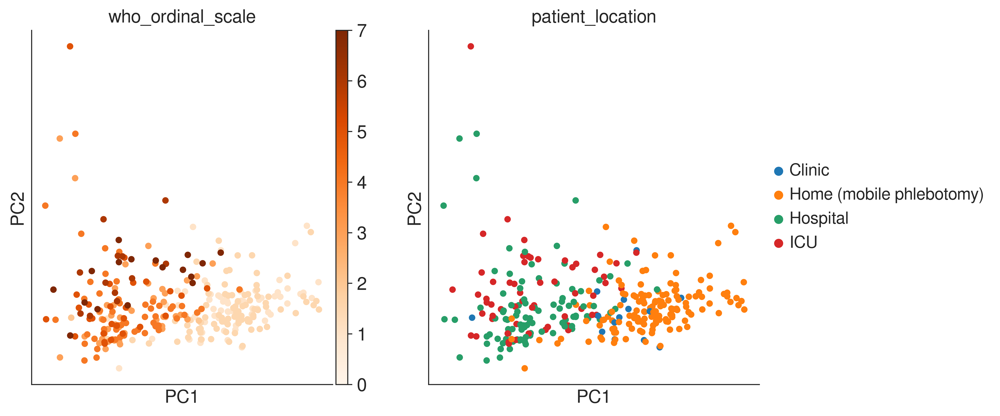

In [52]:
sns.set_style('white')
sns.set_style('ticks', rc={'font':'FreeSans', 'font.family':'sans-serif', 'font.sans-serif':'FreeSans'})
f, axes = plt.subplots(1, 2, figsize=(10, 5), sharex=True, sharey=True)
sns.despine()

fig = sc.pl.pca(adata_serum, color='who_ordinal_scale', size=100, cmap='Oranges', vmin=0, show=False, ax=axes[0])
fig = sc.pl.pca(adata_serum, color='patient_location', size=100, show=False, ax=axes[1])

... storing 'kmeans2' as categorical
... storing 'kmeans3' as categorical
... storing 'kmeans4' as categorical


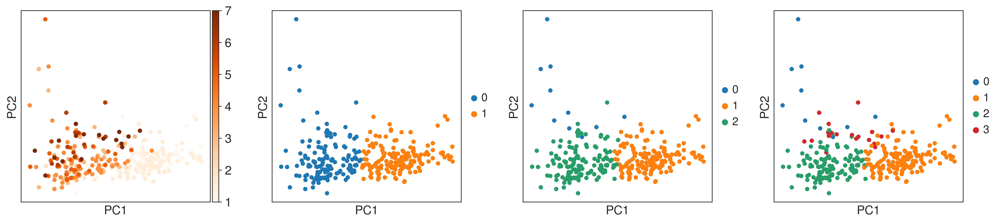

In [53]:
# extract pca coordinates
X_pca = adata_serum.obsm['X_pca'] 

# kmeans with k=2
kmeans = KMeans(n_clusters=2, random_state=0).fit(X_pca) 
adata_serum.obs['kmeans2'] = kmeans.labels_.astype(str)

# kmeans with k=3
kmeans = KMeans(n_clusters=3, random_state=0).fit(X_pca) 
adata_serum.obs['kmeans3'] = kmeans.labels_.astype(str)

# kmeans with k=4
kmeans = KMeans(n_clusters=4, random_state=0).fit(X_pca) 
adata_serum.obs['kmeans4'] = kmeans.labels_.astype(str)

sc.pl.pca(adata_serum, color=['who_ordinal_scale', 'kmeans2', 'kmeans3', 'kmeans4'], title=['', '', '', ''], 
          cmap='Oranges', size=100)

# 2 clusters separates between relatively well and sick patients (e.g. by degree of pulmonary infiltration)

In [54]:
# Most important PCA components
# Get loading scores of the first two PCs and find the most highly scored metabolites per PC
loading_scores = pd.DataFrame(abs(adata_serum.varm['PCs'][:, 0:2]), columns=['PC1', 'PC2'])
loading_scores.index = adata_serum.var_names
#loading_scores.to_csv(master_dir + 'output/metabolite-PCA1_2-absolute_loading_scores-alt_normalization.csv')
loading_scores = loading_scores.sort_values(by='PC1', ascending=False).reset_index()
np.where(loading_scores['index']=='mannose')

(array([87]),)

In [55]:
loading_scores[:50]

,index,PC1,PC2
0,phenylalanylmethionine,0.127489,0.022747
1,1-linoleoyl-2-docosahexaenoyl-GPC (18:2/22:6)*,0.118173,0.018156
2,1-stearoyl-GPC (18:0),0.113705,0.015418
3,1-palmitoyl-GPC (16:0),0.108503,0.000562
4,"1,2-dilinoleoyl-GPC (18:2/18:2)",0.104703,0.006815
5,isoleucylleucine/leucylisoleucine,0.101947,0.024818
6,1-linoleoyl-GPC (18:2),0.099032,0.008286
7,1-(1-enyl-palmitoyl)-GPE (P-16:0)*,0.096901,0.004397
8,1-dihomo-linolenoyl-GPC (20:3n3 or 6)*,0.096285,0.017369
9,1-(1-enyl-stearoyl)-GPE (P-18:0)*,0.096145,0.009365


In [56]:
np.where(loading_scores['index']=='sphingomyelin (d18:2/14:0, d18:1/14:1)*')

(array([18]),)

In [57]:
np.where(loading_scores['index']=='sphingomyelin (d18:1/21:0, d17:1/22:0, d16:1/23:0)*')

(array([19]),)

In [58]:
np.where(loading_scores['index']=='2-linoleoyl-GPE (18:2)*')

(array([20]),)

In [59]:
np.where(loading_scores['index']=='1-linoleoyl-GPE (18:2)*')

(array([38]),)

In [60]:
np.where(loading_scores['index']=='1-(1-enyl-palmitoyl)-2-linoleoyl-GPC (P-16:0/18:2)*')

(array([54]),)

### Correlation of metabolites with WHO scale
Select these and plot just these

In [61]:
adata_serum.obs.index = adata_serum.obs['sample_id']

In [63]:
adata_serum.obs.sort_values(by='who_ordinal_scale', axis=0)['sample_id']

sample_id
INCOV066-CV    INCOV066-CV
INCOV078-BL    INCOV078-BL
INCOV108-BL    INCOV108-BL
INCOV024-CV    INCOV024-CV
INCOV051-CV    INCOV051-CV
                  ...     
INCOV035-BL    INCOV035-BL
INCOV020-BL    INCOV020-BL
INCOV106-BL    INCOV106-BL
INCOV008-BL    INCOV008-BL
INCOV061-CV    INCOV061-CV
Name: sample_id, Length: 308, dtype: object

In [73]:
# For correlation, not using the statistically deleted values (need raw values)
#df_p = pd.DataFrame(p)
#df_p.index = metab_genes.index
#patients = adata.obs['patient'].unique().astype(str)
#patients.sort()
#df_p.columns = patients

# Plot in order of increasing WHO score
patients_WHO = adata_serum.obs.sort_values(by='who_ordinal_scale', axis=0).dropna(subset=[\
                                'who_ordinal_scale'], axis=0)['sample_id'].unique()
adata_serum.X = pre_norm
adata_serum_sorted = pd.DataFrame(adata_serum[patients_WHO].X, columns=adata_serum.var_names, 
                                  index=adata_serum[patients_WHO].obs.index)
df_p = adata_serum_sorted.transpose()

spr_corr = df_p.apply(lambda col: spearmanr(col, adata_serum.obs.loc[patients_WHO, ['who_ordinal_scale']])[0], 
                      axis=1)
spr_pvalues = df_p.apply(lambda col: spearmanr(col, adata_serum.obs.loc[patients_WHO, ['who_ordinal_scale']])[1], 
                         axis=1)

sig_metabolites = pd.DataFrame([spr_corr, spr_pvalues]).transpose()
sig_metabolites = sig_metabolites[sig_metabolites.loc[:, 1]<0.05]
sig_metabolites.columns = ['Spearman', 'p-value']
sig_metabolites['Spearman_abs'] = abs(sig_metabolites['Spearman'])
sig_metabolites['-log10(p)'] = -np.log10(sig_metabolites['p-value'])
sig_metabolites['p-value_bh'] = fdrcorrection(sig_metabolites['p-value'])[1].flatten()
sig_metabolites = sig_metabolites.sort_values(by='Spearman_abs', ascending=False)
pd.DataFrame(sig_metabolites).to_csv(master_dir + 'output/' + 
                                 celltype + '-metabolites-data_200905-210416.csv')
sig_metabolites

/home/jwlee/.local/lib/python3.8/site-packages/scipy/stats/stats.py:4196: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())


,Spearman,p-value,Spearman_abs,-log10(p),p-value_bh
6-bromotryptophan,-0.721879,1.085837e-50,0.721879,49.964235,8.002619e-48
phenylalanylmethionine,-0.706817,9.033646e-48,0.706817,47.044137,3.328899e-45
3-ureidopropionate,0.687421,2.841789e-44,0.687421,43.546408,6.981329e-42
tryptophylleucine,-0.680741,3.940930e-43,0.680741,42.404401,6.037972e-41
mannose,0.680641,4.096317e-43,0.680641,42.387606,6.037972e-41
...,...,...,...,...,...
N-stearoyl-sphinganine (d18:0/18:0)*,0.113962,4.602767e-02,0.113962,1.336981,4.627884e-02
ornithine,0.113164,4.758332e-02,0.113164,1.322545,4.777781e-02
4-chlorobenzoic acid,0.112562,4.878520e-02,0.112562,1.311712,4.891795e-02
methionylalanine,-0.112343,4.922920e-02,0.112343,1.307777,4.929608e-02


Checking Benjamini-Hochberg-corrected p values with uncorrected p values for different thresholds:

In [74]:
sum((sig_metabolites['p-value_bh'] < 0.05) & (sig_metabolites['Spearman'] > 0))

227

In [75]:
sum((sig_metabolites['p-value'] < 0.05) & (sig_metabolites['Spearman'] > 0))

227

In [76]:
sum((sig_metabolites['p-value_bh'] < 0.001) * (sig_metabolites['Spearman'] > 0))

/home/jwlee/.local/lib/python3.8/site-packages/pandas/core/computation/expressions.py:203: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  warnings.warn(


158

In [77]:
sum((sig_metabolites['p-value'] < 0.001) * (sig_metabolites['Spearman'] > 0))

/home/jwlee/.local/lib/python3.8/site-packages/pandas/core/computation/expressions.py:203: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  warnings.warn(


160

In [78]:
sum((sig_metabolites['p-value_bh'] < 0.05) * (sig_metabolites['Spearman'] < 0))

/home/jwlee/.local/lib/python3.8/site-packages/pandas/core/computation/expressions.py:203: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  warnings.warn(


510

In [79]:
sum((sig_metabolites['p-value'] < 0.05) * (sig_metabolites['Spearman'] < 0))

/home/jwlee/.local/lib/python3.8/site-packages/pandas/core/computation/expressions.py:203: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  warnings.warn(


510

In [80]:
sum((sig_metabolites['p-value_bh'] < 0.001) * (sig_metabolites['Spearman'] < 0))

/home/jwlee/.local/lib/python3.8/site-packages/pandas/core/computation/expressions.py:203: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  warnings.warn(


424

In [81]:
sum((sig_metabolites['p-value'] < 0.001) * (sig_metabolites['Spearman'] < 0))

/home/jwlee/.local/lib/python3.8/site-packages/pandas/core/computation/expressions.py:203: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  warnings.warn(


429

In [44]:
fig = plt.figure(figsize=(30, 60))
df_sorted = df_p.loc[sig_metabolites[sig_metabolites['p-value_bh']<0.001].sort_values(by='Spearman', 
                                                                                   ascending=False).index]
fig = sns.heatmap(df_sorted, cmap='magma', vmax=5)
plt.xlabel('')
plt.xticks([])

([], [])

In [27]:
fig = plt.figure(figsize=(30, 60))
df_sorted = df_p.loc[sig_metabolites[sig_metabolites['p-value']<0.001].sort_values(by='Spearman', 
                                                                                   ascending=False).index]
fig = sns.heatmap(df_sorted, cmap='magma', vmax=5)
plt.xlabel('')
plt.xticks([])

([], [])

In [28]:
len(sig_metabolites[sig_metabolites['p-value']<0.001][sig_metabolites['Spearman']<0])

<ipython-input-28-6dc81c31e914>:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  len(sig_metabolites[sig_metabolites['p-value']<0.001][sig_metabolites['Spearman']<0])


429

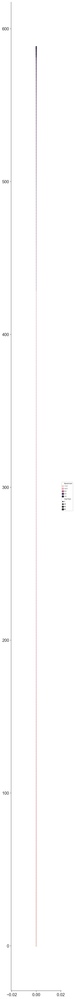

In [115]:
def plot_spearman_dots(sig_pathways, df_corresponding, figsize=(5, 3)):
    # Dot plot for the significant ones
    sns.set_style('white')
    sns.set_style('ticks')
    fig = plt.figure(figsize=figsize)
    fig = sns.scatterplot(x=np.zeros(len(sig_pathways)), y=np.arange(0, len(sig_pathways), 1)[::-1], 
                          hue='Spearman', size='-log10(p)', hue_order=np.arange(0, 0.5, 0.1), 
                          sizes=(10, 40), data=sig_pathways.loc[df_corresponding.index])
    fig.legend(loc='right', bbox_to_anchor=(1.25, 0.5), ncol=1, fontsize=6)
    sns.despine()
    
plot_spearman_dots(sig_metabolites[sig_metabolites['p-value']<0.001], 
                   df_sorted, figsize=(3, 60))

<Figure size 1200x1200 with 0 Axes>

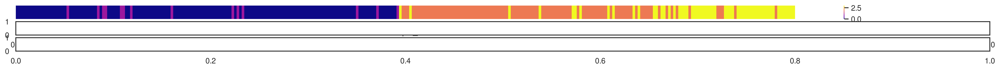

<Figure size 4800x90 with 0 Axes>

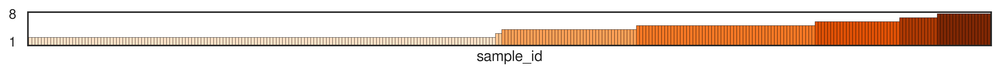

In [31]:
# Other patient attributes
adata_obs_by_patient = adata_serum.obs.copy().dropna(subset=['who_ordinal_scale'])
adata_obs_by_patient.index = adata_obs_by_patient['sample_id']
adata_obs_by_patient = adata_obs_by_patient.reset_index(drop=True)
adata_obs_by_patient = adata_obs_by_patient.groupby(by='sample_id').first() # All characteristics except clustering should be the same
adata_obs_by_patient['who_ordinal_scale'] = adata_obs_by_patient['who_ordinal_scale'].astype(int)

# Plotting the other patient attributes
sns.set_style(style='white', rc={'font':'FreeSans', 'font.family':'sans-serif', 'font.sans-serif':'FreeSans'})
#sns.set(style='ticks')
sns.despine()

f, axes = plt.subplots(3, 1, figsize=(25, 1.2), sharex=False, sharey=False)

df = adata_obs_by_patient.loc[patients_WHO, ['patient_location']]
df['patient_location'] = df['patient_location'].map({'Home (mobile phlebotomy)': 0, 'Clinic': 1, 
                                                     'Hospital': 2, 'ICU': 3}).astype(int)
fig = plt.figure(figsize=(16, 0.3))
fig = sns.heatmap(df.transpose(), xticklabels=[''], yticklabels=[''],
                 cmap='plasma', ax=axes[0])

df = adata_obs_by_patient.loc[patients_WHO, ['who_ordinal_scale']]
df['who_ordinal_scale'] += 1 # Add 1 to all values in order to make all bars visible
fig = plt.figure(figsize=(14, 0.5))
oranges = cm.get_cmap('Oranges', 8)
df['c'] = [oranges(s - 1) for s in df['who_ordinal_scale']]
fig = df['who_ordinal_scale'].plot(kind='bar', color=df['c'], edgecolor='black', linewidth=0.25, width=1)
fig = plt.yticks([1, 8])
fig = plt.xticks([])

In [34]:
# Save metabolites adata for convenient use later
#adata_serum_sorted.to_csv(master_dir + 'output/all-metabolites-concentrations-data_200905.csv')

## Patient pseudobulk gene expression

In [32]:
df_pseudobulk = pd.read_csv(master_dir + 
            'data/PBMC/upto_tenth8_t1t2h_rev_bulk_gex_per_patient_suprisal_format_wo_86_2_145_2.csv', header=0)
df_pseudobulk.head()

,celltype,gene,P_1-1,P_1-2,P_2-1,P_2-2,P_3-1,P_3-2,P_4-1,P_4-2,...,3577BW,5046BW,6130BW,7541BW,BP0219101,BP0319250,BP05191345,BP08191115,CL2,Mix_donor1
0,Monocytes,A1BG,1.074493,1.267069,0.422910,0.925235,1.342639,1.426002,0.369201,0.290283,...,0.748158,1.081492,0.938759,1.158623,1.026053,1.453970,1.262222,1.148289,1.025626,1.161736
1,Monocytes,A1BG-AS1,0.072859,0.067354,0.065851,0.078755,0.115363,0.092565,0.036213,0.010142,...,0.000000,0.033366,0.013343,0.067788,0.090404,0.062069,0.067130,0.066888,0.058774,0.118689
2,Monocytes,A2M,0.000000,0.000000,0.000000,0.004562,0.000000,0.007171,0.000000,0.000000,...,0.000000,0.000000,0.006715,0.012825,0.000000,0.000000,0.000000,0.000000,0.001765,0.000000
3,Monocytes,A2M-AS1,0.003439,0.000000,0.014757,0.024716,0.014558,0.025297,0.018754,0.011379,...,0.000000,0.000000,0.000000,0.006606,0.043718,0.000000,0.000000,0.000000,0.007275,0.029735
4,Monocytes,A2ML1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.001251,0.000000


In [33]:
df_pseudobulk['celltype'].unique()

array(['Monocytes', 'CD8+ T-cells', 'CD4 T-cells', 'B-cells', 'NK-cells'],
      dtype=object)

## Assocation of serum metabolites with metabolic pathways

In [34]:
del adata
del adata_metab

In [53]:
def metabolite_vs_pathway():
    # Map the metabolite sample_ids with the anndata
    sample_map_old = pd.read_csv(master_dir + 'data/sample_association-200705_cleaned.csv')
    
    #celltypes = ['all', 'cd8', 'cd4', 'B_wo_patient4', 'NK', 'Monocyte']
    # Dominant subpopulations only
    celltypes = ['cd8-metab_cluster_4', 'cd4-metab_cluster_6', 'B_wo_patient4-metab_cluster_3', 
                 'NK-metab_cluster_4', 'Monocyte-metab_cluster_0_1']
    clusters = [['4'], ['6'], ['3'], ['4'], ['0', '1']]
    corr_r_sigs = []
    corr_p_sigs = []

    for i, c in enumerate(celltypes):
        c_major = c.split('-')[0]
        adata = sc.read_h5ad(master_dir + 'output/' + c_major + '-processed-analyzed-metab.h5ad')

        adata = adata[adata.obs['louvain'].isin(clusters[i])]
        patients = adata.obs.sort_values(by='WHO_scale', axis=0)['patient'].unique()
        
        # Load the pathway activities for all cells per patient
        pathway_activities_all = pd.read_csv(master_dir + 'output/pathway_activity/' + c + 
                                             '-metab-patient-pathway_activity.tabular', 
                                             sep='\t', header=None)
        pathway_activities_all.index = metab_pathway_list
        pathway_activities_all.columns = patients

        # Merge the pathway activities and serum metabolites per patient
        df_serum_and_pathways = pd.merge(sample_map_old.loc[:, ['sample_name', 'sample_id']], df_serum, 
                                         left_on='sample_id', right_index=True, how='inner')
        df_serum_and_pathways = pd.merge(df_serum_and_pathways, pathway_activities_all.transpose(), left_on='sample_name', 
                                         right_index=True, how='inner')
        df_serum_and_pathways = df_serum_and_pathways.drop(columns=['sample_id', 'sample_name'])

        # Pick pathways that are already significantly correlated with WHO scale
        sig_pathways = pd.read_csv(master_dir + 'output/pathway_activity/pathway_activity_trends/' + 
                                   c + '.csv', 
                                   sep=',', header=0)
        sig_pathways.index = sig_pathways['0']
        sig_pathways = sig_pathways.drop(columns='0')
    
        # [-90:] is the pathway activities, # [:-90] is the serum metabolites per patient
        df_serum_merged = df_serum_and_pathways.iloc[:, :-90]
        df_pathways_merged = df_serum_and_pathways.iloc[:, -90:]

        df_serum_merged = df_serum_merged.dropna(axis=1)
        #df_pathways_merged = df_pathways_merged.dropna(axis=1)

        # Resulting correlation dataframe has an array of Spearman r values and p values for each metabolite for each pathway
        corr_r = pd.DataFrame(np.zeros([len(df_serum_merged.columns), 
                                        len(df_pathways_merged.columns)])) # R values
        corr_p = pd.DataFrame(np.ones([len(df_serum_merged.columns), 
                                       len(df_pathways_merged.columns)])) # p values

        corr_r.columns = df_pathways_merged.columns
        corr_p.columns = df_pathways_merged.columns

        corr_r.index = df_serum_merged.columns
        corr_p.index = df_serum_merged.columns

        for metabolite in df_serum_merged.columns:
            temp = df_pathways_merged.apply(lambda col: spearmanr(col, df_serum_merged.loc[:, metabolite]))
            corr_r.loc[metabolite] = temp.iloc[0]
            corr_p.loc[metabolite] = temp.iloc[1]

        # Filter in just the correlations that have significant p values
        corr_r_sig = corr_r * (corr_p < 0.05)
        corr_p_sig = corr_p 
        
        # Just the metabolites and pathways that are also correlated with WHO
        corr_r_sig_WHO = corr_r_sig.loc[set(set(sig_metabolites.index)).intersection(set(corr_r_sig.index)), 
                                        sig_pathways.index]
        corr_r_sig_WHO.columns = c_major + '_' + corr_r_sig_WHO.columns
        
        corr_p_sig_WHO = corr_p_sig.loc[set(set(sig_metabolites.index)).intersection(set(corr_p_sig.index)), 
                                        sig_pathways.index]
        corr_p_sig_WHO.columns = c_major + '_' + corr_p_sig_WHO.columns

        corr_r_sigs.append(corr_r_sig_WHO)
        corr_p_sigs.append(corr_p_sig_WHO)
        
        print(c + ' done')
        del adata # Mitigate memory leak?
        del patients
    
    corr_r_sigs = pd.concat(corr_r_sigs, axis=1)
    corr_p_sigs = pd.concat(corr_p_sigs, axis=1)
    
    # Drop any serum metabolites or pathway activiites that have no correlation with anything of the other type
    corr_p_sigs = corr_p_sigs.loc[(corr_r_sigs != 0).any(axis=1), (corr_r_sigs != 0).any(axis=0)]
    corr_r_sigs = corr_r_sigs.loc[(corr_r_sigs != 0).any(axis=1), (corr_r_sigs != 0).any(axis=0)]

    #fig = plt.figure(figsize=(15, 15))
    #fig = sns.heatmap(corr_r_sig_WHO, cmap='coolwarm', norm=DivergingNorm(0.0))
    #corr_r_sigs.to_csv(master_dir + 'output/pathway_activity/correlation_w_metabolites.csv') # For p < 0.05
    #corr_r_sigs.to_csv(master_dir + 'output/pathway_activity/correlation_w_metabolites-strict.csv') # For p < 0.01
    #corr_p_sigs.to_csv(master_dir + 'output/pathway_activity/correlation_w_metabolites-strict-pvals.csv')
    
    return corr_r_sigs, corr_p_sigs

In [54]:
corrs, pvals = metabolite_vs_pathway()

cd8-metab_cluster_4 done
cd4-metab_cluster_6 done
B_wo_patient4-metab_cluster_3 done
NK-metab_cluster_4 done
Monocyte-metab_cluster_0_1 done


In [56]:
corrs

0,cd8_Tyrosine metabolism,"cd8_Alanine, aspartate and glutamate metabolism",cd8_Pyruvate metabolism,cd8_Pyrimidine metabolism,cd8_Steroid hormone biosynthesis,cd8_Mannose type O-glycan biosynthesis,"cd8_Cutin, suberine and wax biosynthesis",cd8_Galactose metabolism,cd8_Glycerolipid metabolism,cd8_Vitamin B6 metabolism,...,Monocyte_Histidine metabolism,Monocyte_Glycosaminoglycan biosynthesis - keratan sulfate,Monocyte_Thiamine metabolism,Monocyte_Mucin type O-glycan biosynthesis,Monocyte_One carbon pool by folate,Monocyte_Terpenoid backbone biosynthesis,Monocyte_Prodigiosin biosynthesis,Monocyte_Synthesis and degradation of ketone bodies,Monocyte_Folate biosynthesis,Monocyte_N-Glycan biosynthesis
1-eicosapentaenoyl-GPC (20:5)*,-0.0,0.000000,-0.000000,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,...,0.0,-0.0,-0.0,0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0
urea,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,-0.0,-0.0,-0.0,-0.0,0.0,0.0,0.0,-0.0,-0.0
1-(1-enyl-stearoyl)-2-oleoyl-GPC (P-18:0/18:1),-0.0,-0.000000,0.000000,-0.0,-0.0,0.0,-0.0,-0.0,-0.0,-0.0,...,0.0,-0.0,-0.0,0.0,-0.0,-0.0,-0.0,0.0,-0.0,-0.0
1-linoleoyl-GPC (18:2),-0.0,0.000000,0.000000,0.0,0.0,0.0,-0.0,0.0,0.0,0.0,...,0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0
phenylacetylcarnitine,-0.0,-0.327445,-0.309942,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
xanthine,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
"3-bromo-5-chloro-2,6-dihydroxybenzoic acid*",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
stearate (18:0),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1-methyl-4-imidazoleacetate,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [57]:
corrs.to_csv(master_dir + 'output/pathway_activity/correlation_w_metabolites-dominant_only.csv') # For p < 0.05
pvals.to_csv(master_dir + 'output/pathway_activity/correlation_w_metabolites-dominant_only-pvals.csv')

In [55]:
links = corrs.stack().reset_index()
plinks = pvals.stack().reset_index()
links.columns = ['var1', 'var2', 'Spearman_r']
links['p'] = plinks.iloc[:, -1] # p values column
links_filtered = links.loc[(links['var1'] != links['var2']) & (links['p'] < 0.01)]
links_filtered.to_csv(master_dir + 'output/pathway_activity/correlation_w_metabolites-dominant_only-converted_nodes.csv')

In [58]:
master_corrs = pd.read_csv(master_dir + 'output/pathway_activity/correlation_w_metabolites-dominant_only.csv')
master_corrs.index = master_corrs['Unnamed: 0']
master_corrs = master_corrs.drop(columns=['Unnamed: 0'])
master_corrs.head()

,cd8_Tyrosine metabolism,"cd8_Alanine, aspartate and glutamate metabolism",cd8_Pyruvate metabolism,cd8_Pyrimidine metabolism,cd8_Steroid hormone biosynthesis,cd8_Mannose type O-glycan biosynthesis,"cd8_Cutin, suberine and wax biosynthesis",cd8_Galactose metabolism,cd8_Glycerolipid metabolism,cd8_Vitamin B6 metabolism,...,Monocyte_Histidine metabolism,Monocyte_Glycosaminoglycan biosynthesis - keratan sulfate,Monocyte_Thiamine metabolism,Monocyte_Mucin type O-glycan biosynthesis,Monocyte_One carbon pool by folate,Monocyte_Terpenoid backbone biosynthesis,Monocyte_Prodigiosin biosynthesis,Monocyte_Synthesis and degradation of ketone bodies,Monocyte_Folate biosynthesis,Monocyte_N-Glycan biosynthesis
Unnamed: 0,,,,,,,,,,,,,,,,,,,,,
1-eicosapentaenoyl-GPC (20:5)*,-0.0,0.000000,-0.000000,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,...,0.0,-0.0,-0.0,0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0
urea,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,-0.0,-0.0,-0.0,-0.0,0.0,0.0,0.0,-0.0,-0.0
1-(1-enyl-stearoyl)-2-oleoyl-GPC (P-18:0/18:1),-0.0,-0.000000,0.000000,-0.0,-0.0,0.0,-0.0,-0.0,-0.0,-0.0,...,0.0,-0.0,-0.0,0.0,-0.0,-0.0,-0.0,0.0,-0.0,-0.0
1-linoleoyl-GPC (18:2),-0.0,0.000000,0.000000,0.0,0.0,0.0,-0.0,0.0,0.0,0.0,...,0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0
phenylacetylcarnitine,-0.0,-0.327445,-0.309942,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [83]:
master_p = pd.read_csv(master_dir + 'output/pathway_activity/correlation_w_metabolites-dominant_only-pvals.csv',
                      index_col=0)
master_p.head()

,cd8_Tyrosine metabolism,"cd8_Alanine, aspartate and glutamate metabolism",cd8_Pyruvate metabolism,cd8_Pyrimidine metabolism,cd8_Steroid hormone biosynthesis,cd8_Mannose type O-glycan biosynthesis,"cd8_Cutin, suberine and wax biosynthesis",cd8_Galactose metabolism,cd8_Glycerolipid metabolism,cd8_Vitamin B6 metabolism,...,Monocyte_Histidine metabolism,Monocyte_Glycosaminoglycan biosynthesis - keratan sulfate,Monocyte_Thiamine metabolism,Monocyte_Mucin type O-glycan biosynthesis,Monocyte_One carbon pool by folate,Monocyte_Terpenoid backbone biosynthesis,Monocyte_Prodigiosin biosynthesis,Monocyte_Synthesis and degradation of ketone bodies,Monocyte_Folate biosynthesis,Monocyte_N-Glycan biosynthesis
1-eicosapentaenoyl-GPC (20:5)*,0.242530,0.943562,0.987403,0.929788,0.967094,0.365134,0.365682,0.731592,0.398309,0.226473,...,0.967878,0.504925,0.820708,0.749968,0.540625,0.354943,0.466435,0.482662,0.665712,0.559746
urea,0.306411,0.907147,0.739285,0.383480,0.103142,0.579815,0.284338,0.264219,0.171233,0.213854,...,0.329747,0.497619,0.564713,0.923196,0.690800,0.936130,0.982151,0.947136,0.952967,0.744411
1-(1-enyl-stearoyl)-2-oleoyl-GPC (P-18:0/18:1),0.765625,0.490758,0.891824,0.797735,0.388576,0.792228,0.696549,0.699573,0.944373,0.651770,...,0.918674,0.921904,0.427179,0.855055,0.500222,0.571369,0.725374,0.974365,0.813118,0.547690
1-linoleoyl-GPC (18:2),0.361312,0.189390,0.389144,0.504437,0.542516,0.933027,0.779678,0.918460,0.980903,0.971967,...,0.998377,0.248571,0.586473,0.826411,0.380382,0.326067,0.331803,0.320393,0.601184,0.316379
phenylacetylcarnitine,0.122512,0.034278,0.045768,0.253219,0.472189,0.242109,0.259781,0.223670,0.347327,0.365134,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


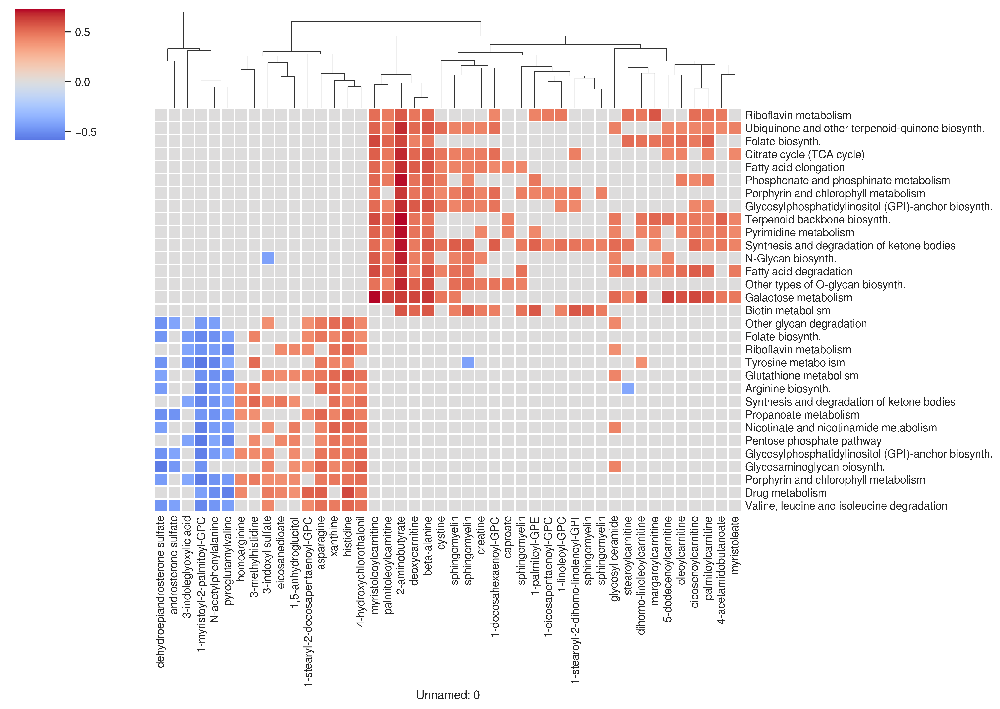

In [109]:
#corrs = master_corrs.iloc[:, 22:] # Remove all_ columns
corrs = master_corrs #* (master_p < 0.01)
corrs = corrs.fillna(value=0)
# To make patterns more clear, restrict metabolites to only the ones that correlate with at least 5 pathways
#corrs = corrs.loc[(corrs != 0).sum(axis=1) > 4, :]
#corrs = corrs.loc[(corrs != 0).sum(axis=1) > 5, (corrs != 0).sum(axis=0) > 10]
corrs = corrs.loc[:, (corrs != 0).sum(axis=0) > 10]
corrs = corrs.loc[(corrs != 0).sum(axis=1) > 5]
corrs = corrs.loc[:, (corrs != 0).sum(axis=0) > 10]
# Filter out metabolic pathways that do not have any metabolites linked to it after the above filtering
corrs = corrs.loc[:, (corrs != 0).any(axis=0)]
fig = sns.clustermap(corrs.transpose(), figsize=(14, 10), cmap='coolwarm', center=0, #vmin=-1, vmax=1,
                     linewidths=1.5, row_cluster=False, linecolor='white',
                     #yticklabels=pd.Series(corrs.columns).apply(lambda x: x.replace('biosynthesis', 'biosynth.')),
                     yticklabels=pd.Series(corrs.columns).apply(lambda x: x.split('_')[-1].split(' - ')[0].replace('biosynthesis', 'biosynth.')),
                     xticklabels=pd.Series(corrs.index).apply(lambda x: x.split(' (')[0]))
fig.ax_heatmap.tick_params(axis='both', length=0)
#fig.set(xticks=pd.Series(corrs.columns).apply(lambda x: x.split('_')[-1]))
#plt.savefig(master_dir + 
#        'output/pathway_activity/everything-correlation_w_metabolites-best_metabolites-dominant_only-201204.pdf' )

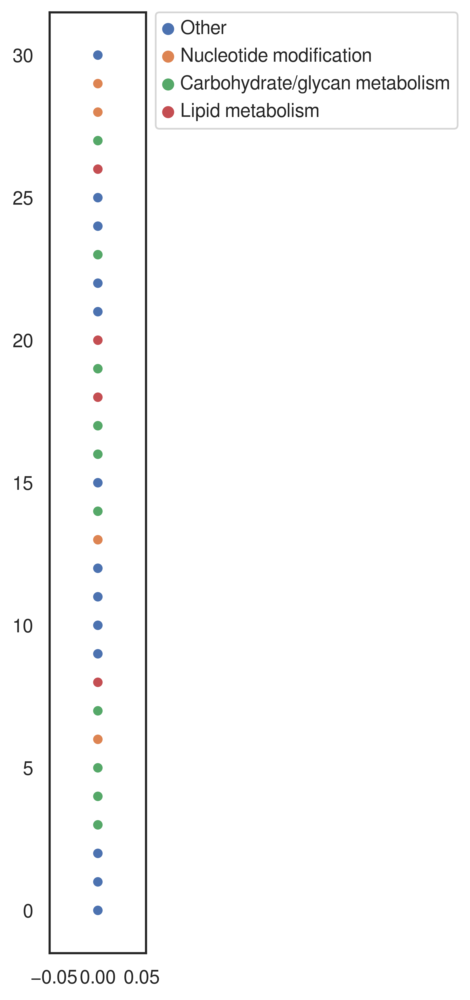

In [107]:
#sns.set_style('white')
pathways = pd.Series(corrs.columns).apply(lambda x: x.split('_')[-1])
pathway_classifications = pd.read_csv(master_dir + 'data/KEGG_genesets/hsa00001.metab.keg-KEGGclassified.gmt', 
                                      sep='\t', header=None)
pathway_classifications.columns = ['pathway', 'classification']
pathway_classifications.index = pathway_classifications['pathway']
pathway_classifications['superpathway'] = pathway_classifications['classification'].apply(\
    lambda x: x if x in ['Lipid metabolism'] \
              else 'Carbohydrate/glycan metabolism' if x in ['Carbohydrate metabolism', 'Glycan biosynthesis and metabolism']
#              else 'Nucleotide modification' if x in ['Nucleotide metabolism', 'Cysteine and methionine metabolism',
#                    'Histidine metabolism',
#                    'Ubiquinone and other terpenoid-quinone biosynthesis',
#                    'Taurine and hypotaurine metabolism',
#                    'Nicotinate and nicotinamide metabolism'] \
              else 'Other')

for i in pathway_classifications.index:
    if pathway_classifications.loc[i, 'pathway'] in \
                        ['Nicotinate and nicotinamide metabolism', 'Folate biosynthesis',
                        'Caffeine metabolism', 'Cysteine and methionine metabolism',
                        'Histidine metabolism', 'Ubiquinone and other terpenoid-quinone biosynthesis',
                        'Taurine and hypotaurine metabolism']:
        pathway_classifications.loc[i, 'superpathway'] = 'Nucleotide modification'

#pathway_classifications['color'] = pathway_classifications['superpathway'].map{''}

plt.figure(figsize=(1, 10))
sns.scatterplot(x=np.zeros(len(pathways)), y=range(len(pathways))[::-1], 
    hue=pathway_classifications.loc[pathways, 'superpathway'])
plt.legend(bbox_to_anchor=(1.1, 1), borderaxespad=0)
#plt.savefig(master_dir + 'output/pathway_activity/everything-correlation_w_metabolites-best_metabolites-classifications-201114.svg' )

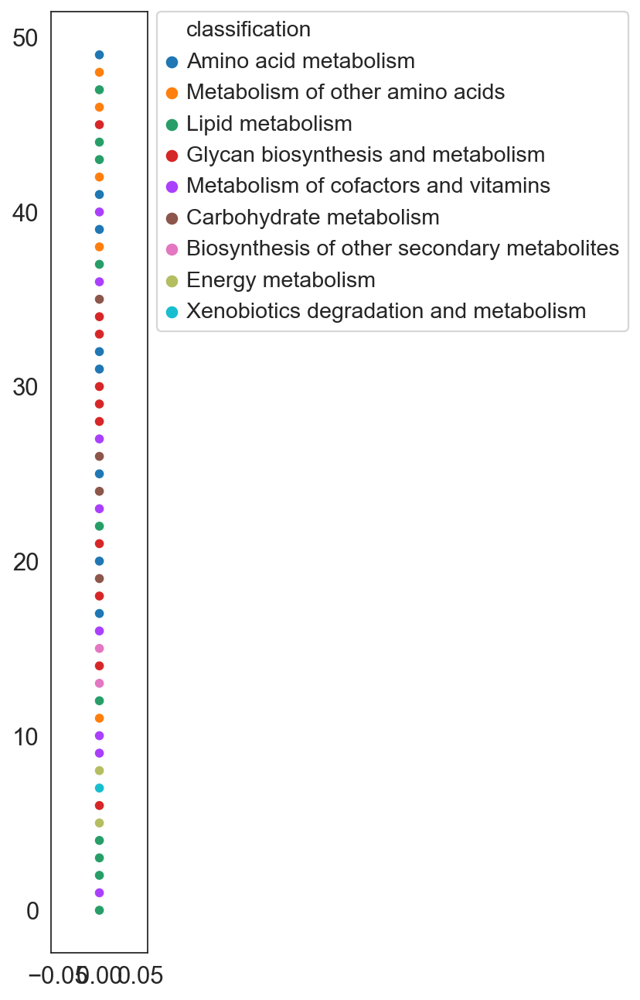

In [67]:
plt.figure(figsize=(1, 10))
sns.scatterplot(x=np.zeros(len(pathways)), y=range(len(pathways))[::-1], 
    hue=pathway_classifications.loc[pathways, 'classification'])

plt.legend(bbox_to_anchor=(1.1, 1), borderaxespad=0)

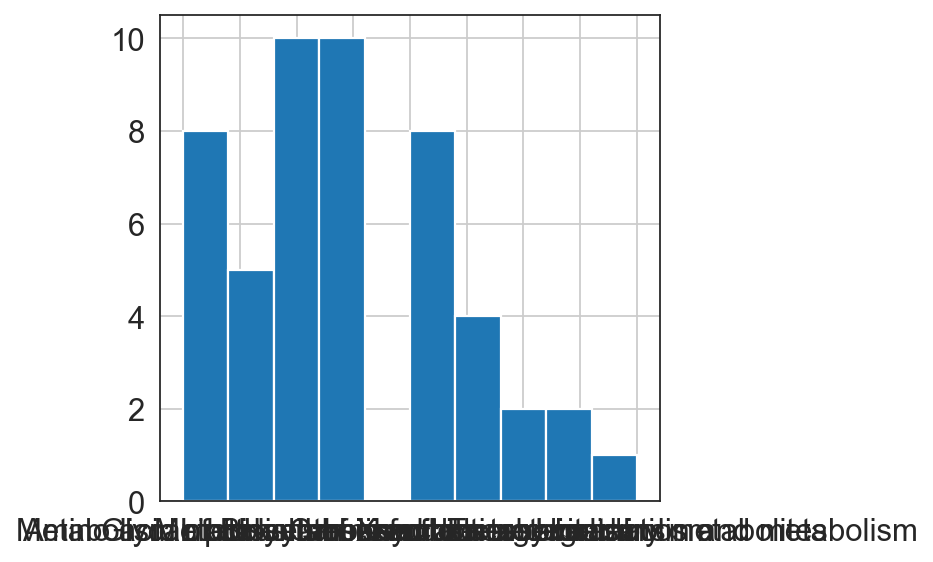

In [75]:
pathway_classifications.loc[pathways, 'classification'].hist()

In [55]:
#corrs.to_csv(master_dir + 'output/pathway_activity/correlation_w_metabolites-best_metabolites.csv')

<ipython-input-56-db24d167784d>:1: MatplotlibDeprecationWarning: 
The DivergingNorm class was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use TwoSlopeNorm instead.
  fig = sns.clustermap(corrs, figsize=(35, 28), cmap='coolwarm', norm=DivergingNorm(0.0),


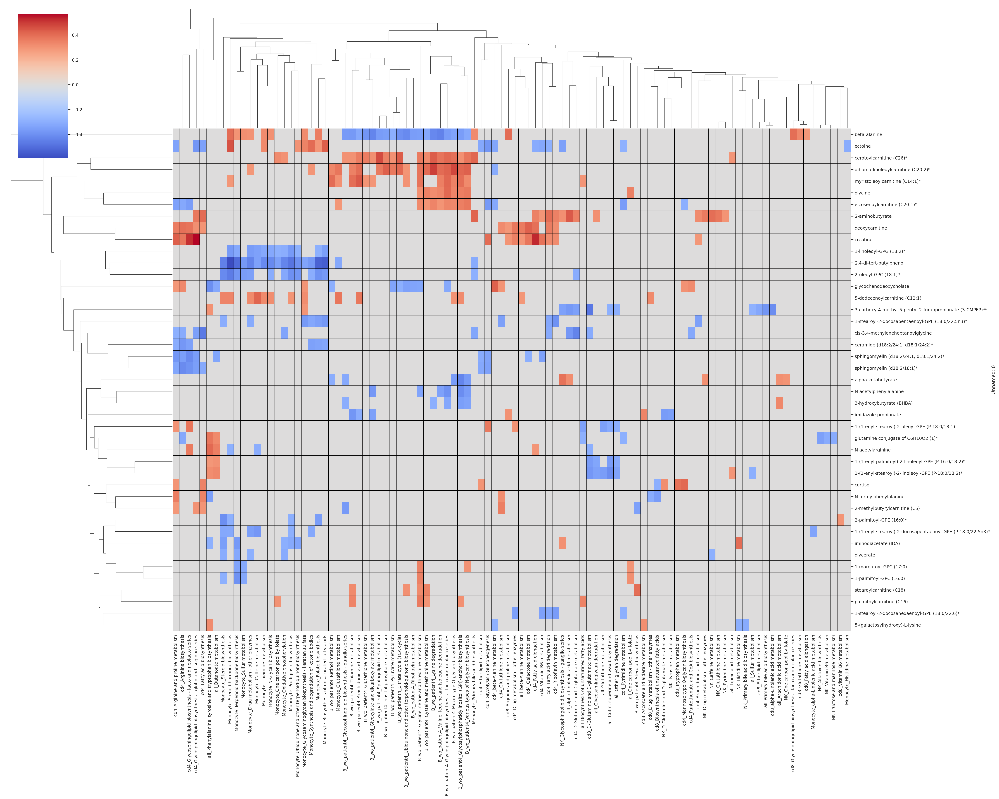

In [56]:
# With hierarchical clustering for the pathways too
fig = sns.clustermap(corrs, figsize=(35, 28), cmap='coolwarm', norm=DivergingNorm(0.0),
                        linewidths=0.1, linecolor='black')
#plt.savefig(master_dir +'output/pathway_activity/correlation_w_metabolites_pathways_clustered.pdf' )

### Patient clustering/classification based on metabolites and pathway activities

In [71]:
# Map the metabolite sample_ids with the anndata
sample_map_old = pd.read_csv(master_dir + 'data/sample_association-200705_cleaned.csv')

celltypes = ['cd8', 'cd4', 'B_wo_patient4', 'NK', 'Monocyte'] #['all', 'cd8', 'cd4', 'B_wo_patient4', 'NK', 'Monocyte']
pathway_activities_list = pd.DataFrame()

for c in celltypes:
    adata = sc.read_h5ad(master_dir + 'output/' + c + '-processed-analyzed.h5ad')
    patients = adata.obs.sort_values(by='WHO_scale', axis=0)['patient'].unique()
    print(patients)

    # Load the pathway activities for all cells per patient
    pathway_activities_all = pd.read_csv(master_dir + 'output/pathway_activity/' + c + 
                                         '-metab-patient-pathway_activity.tabular', 
                                         sep='\t', header=None)
    pathway_activities_all.index = metab_pathway_list
    pathway_activities_all.index = c + '_' + pathway_activities_all.index
    pathway_activities_all.columns = patients
    
    pathway_activities_list = pd.concat([pathway_activities_list, pathway_activities_all], axis=0)
    
    del adata
    del patients

[Mix_donor1, BP0319250, BP0219101, BP05191345, CL2, ..., 36-1, 22-1, 3-1, 20-1, 13-1]
Length: 56
Categories (56, object): [Mix_donor1, BP0319250, BP0219101, BP05191345, ..., 22-1, 3-1, 20-1, 13-1]


FileNotFoundError: [Errno 2] File ../output/pathway_activity/cd8-metab-patient-pathway_activity.tabular does not exist: '../output/pathway_activity/cd8-metab-patient-pathway_activity.tabular'

In [ ]:
# Merge the pathway activities and serum metabolites per patient
df_serum_and_pathways = pd.merge(sample_map_old.loc[:, ['sample_name', 'sample_id']], df_serum, 
                                 left_on='sample_id', right_index=True, how='inner')
df_serum_and_pathways = pd.merge(df_serum_and_pathways, pathway_activities_list.transpose(), left_on='sample_name', 
                                 right_index=True, how='inner')
df_serum_and_pathways.index = df_serum_and_pathways['sample_id']
df_serum_and_pathways = df_serum_and_pathways.drop(columns=['sample_id', 'sample_name'])

# Pick or don't pick? Try both?
# 1) Pick pathways that are already significantly correlated with WHO scale
#sig_pathways = pd.read_csv(master_dir + 'output/pathway_activity/pathway_activity_trends/' + 
#                           c + '-all_cells.csv', 
#                           sep=',', header=0)
#sig_pathways.index = sig_pathways['0']
#sig_pathways = sig_pathways.drop(columns='0')

# 2) Don't limit the pathways 
# (No additional code needed)

# [-90:] is the pathway activities, # [:-90] is the serum metabolites per patient
#df_serum_merged = df_serum_and_pathways.iloc[:, :-90]
#df_pathways_merged = df_serum_and_pathways.iloc[:, -90:]

#df_serum_and_pathways = df_serum_and_pathways.dropna(axis=1)
df_serum_and_pathways    

In [ ]:
df_serum_ann.index = df_serum_ann['sample_id']

In [ ]:
adata_integrated = anndata.AnnData(X=df_serum_and_pathways)
adata_integrated.obs = df_serum_ann.loc[df_serum_and_pathways.index].iloc[:, :-1050]
adata_integrated.obs['who_ordinal_scale'] = adata_integrated.obs['who_ordinal_scale'].apply(\
                                        lambda v: 1 if v=='<=2' else (1.5 if v=='1 or 2' else v))
adata_integrated.obs['who_ordinal_scale'] = adata_integrated.obs['who_ordinal_scale'].astype(float)
adata_integrated

In [ ]:
# Normalization of each metabolite concentration and pathway activity
adata_integrated.X = np.nan_to_num(adata_integrated.X)

tempX = (adata_integrated.X - np.mean(adata_integrated.X, axis=0)) / \
        (np.max(adata_integrated.X, axis=0) - np.min(adata_integrated.X, axis=0)) 
adata_integrated.X = tempX
adata_integrated.X = np.nan_to_num(adata_integrated.X)
#adata_serum.X = np.array(adata_serum.X, dtype=float)
#sc.pp.normalize_total(adata_serum, exclude_highly_expressed=True, layers='all', layer_norm='X')
sc.tl.pca(adata_integrated, svd_solver='arpack')

In [ ]:
#adata_serum.obs['Age_at_baseline'] = adata_serum.obs['Age_at_baseline'].str.replace('Not Recorded', 
#                                                                                              '0').astype(int)
#adata_serum.obs['Age_at_baseline'] = adata_serum.obs['Age_at_baseline'].astype(int)

sns.set_style('white')
sns.set_style('ticks')
f, axes = plt.subplots(1, 2, figsize=(10, 5), sharex=True, sharey=True)
sns.despine()

fig = sc.pl.pca(adata_integrated, color='who_ordinal_scale', size=100, cmap='Oranges', vmin=0, show=False, ax=axes[0])
fig = sc.pl.pca(adata_integrated, color='patient_location', size=100, show=False, ax=axes[1])
#fig = sc.pl.pca(adata_serum, color='observation_days_since_enrollment', size=100, cmap='coolwarm', 
#                show=False, ax=axes[2])
#plt.xlim([-0.25, 0.25])
#plt.ylim([-0.25, 0.25])
#plt.tight_layout()

In [ ]:
# Most important PCA components
# Get loading scores of the first two PCs and find the most highly scored metabolites per PC
loading_scores = pd.DataFrame(abs(adata_integrated.varm['PCs'][:, 0:2]), columns=['PC1', 'PC2'])
loading_scores.index = adata_integrated.var_names
#loading_scores.to_csv(master_dir + 'output/metabolite_pathway_integrated-PCA1_2-absolute_loading_scores.csv')
loading_scores = loading_scores.sort_values(by='PC2', ascending=False).reset_index()
#np.where(loading_scores['index']=='mannose')

In [ ]:
# This time, try selecting only the pathways and metabolites that are significantly correlated with WHO score
# Pick pathways that are already significantly correlated with WHO scale
pathway_activities_list = []

for c in celltypes:
    sig_pathways = pd.read_csv(master_dir + 'output/pathway_activity/pathway_activity_trends/' + 
                               c + '-all_cells.csv', 
                               sep=',', header=0)
    sig_pathways.index = c + '_' + sig_pathways['0']
    sig_pathways = sig_pathways.drop(columns='0')
    
    pathway_activities_list = pathway_activities_list + sig_pathways.index.tolist()

adata_integrated_corr_only = adata_integrated[:, sig_metabolites.index.tolist() + pathway_activities_list]

#adata_serum.X = np.array(adata_serum.X, dtype=float)
#sc.pp.normalize_total(adata_serum, exclude_highly_expressed=True, layers='all', layer_norm='X')
sc.tl.pca(adata_integrated_corr_only, svd_solver='arpack')

sc.pp.neighbors(adata_integrated_corr_only)
sc.tl.umap(adata_integrated_corr_only)
sc.tl.louvain(adata_integrated_corr_only, resolution=0.05)

In [ ]:
sns.set_style('white')
sns.set_style('ticks')
f, axes = plt.subplots(2, 2, figsize=(15, 10), sharex=True, sharey=True)
sns.despine()

#adata_integrated_corr_only.obs['patient_location'] = \
#    adata_integrated_corr_only.obs['patient_location'].apply(lambda x: x.toordinal())
fig = sc.pl.pca(adata_integrated_corr_only, color='who_ordinal_scale', size=100, cmap='Oranges', vmin=0, show=False, ax=axes[0, 0])
fig = sc.pl.pca(adata_integrated_corr_only, color='respiratory_support', size=100, show=False, ax=axes[0, 1])
fig = sc.pl.pca(adata_integrated_corr_only, color='chest_xray_ct', size=100, show=False, ax=axes[1, 0])

adata_integrated_corr_only.obs['patient_locationa'] = \
    adata_integrated_corr_only.obs['patient_location'].copy() # Plotting by patient_location doesn't work for some reason
fig = sc.pl.pca(adata_integrated_corr_only, color='patient_locationa', size=100, show=False, ax=axes[1, 1])
plt.tight_layout()

In [ ]:
# extract pca coordinates
X_pca = adata_integrated_corr_only.obsm['X_pca'] 

# kmeans with k=2
kmeans = KMeans(n_clusters=2, random_state=0).fit(X_pca) 
adata_integrated_corr_only.obs['kmeans2'] = kmeans.labels_.astype(str)

# kmeans with k=3
kmeans = KMeans(n_clusters=3, random_state=0).fit(X_pca) 
adata_integrated_corr_only.obs['kmeans3'] = kmeans.labels_.astype(str)

# kmeans with k=4
kmeans = KMeans(n_clusters=4, random_state=0).fit(X_pca) 
adata_integrated_corr_only.obs['kmeans4'] = kmeans.labels_.astype(str)

sc.pl.pca(adata_integrated_corr_only, color=['kmeans2', 'kmeans3', 'kmeans4'], title=['', '', ''], size=100)

# 2 clusters separates between relatively well and sick patients (e.g. by degree of pulmonary infiltration)
# 3 clusters separates between well, sick, and critically ill patients 
# (e.g. by respiratory support needed/hospitalization status)

In [ ]:
# Most important PCA components
# Get loading scores of the first two PCs and find the most highly scored metabolites per PC
loading_scores = pd.DataFrame(abs(adata_integrated_corr_only.varm['PCs']))
loading_scores.index = adata_integrated_corr_only.var_names
#loading_scores.to_csv(master_dir + 'output/metabolite_pathway_corrs_only_integrated-PCA-absolute_loading_scores.csv')
#loading_scores = loading_scores.sort_values(by='PC1', ascending=False).reset_index()
#np.where(loading_scores['index']=='mannose')

In [ ]:
# Most important PCA components
# Get loading scores of the first two PCs and find the most highly scored metabolites per PC
loading_scores = pd.DataFrame(adata_integrated_corr_only.varm['PCs'])
loading_scores.index = adata_integrated_corr_only.var_names
#loading_scores.to_csv(master_dir + 'output/metabolite_pathway_corrs_only_integrated-PCA-loading_scores.csv')
#loading_scores = loading_scores.sort_values(by='PC1', ascending=False).reset_index()
#np.where(loading_scores['index']=='mannose')

In [ ]:
sc.pl.umap(adata_integrated_corr_only, color='louvain', use_raw=False, cmap='viridis')

### Using the above as a predictive cohort and testing on a larger dataset

In [ ]:
patients_WHO_alt_names = patients_WHO.copy()
patients_WHO_alt_names = [pt[5:8] + '-2' if pt[-2:]=='AC' else pt[5:8] + '-1' if pt[-2:]=='BL' else 
                          pt[5:8] + '-3' for pt in patients_WHO_alt_names]
patients_WHO_alt_names = [pt[2:] if pt[0:2]=='00' else pt[1:] if pt[0]=='0' else 
                          pt for pt in patients_WHO_alt_names]

In [ ]:
celltypes = ['cd8', 'cd4', 'B_wo_patient4', 'NK', 'Monocyte']
dfs = []
for i in range(5):
    df = pd.read_csv(master_dir + 'output/pathway_activity/' + celltypes[i] + 
                       '-metab-patient-pathway_activity_from_pseudobulk-201101.tabular', sep='\t', header=0)
    df.index = celltypes[i] + '_' + metab_genes.index
    dfs.append(df)
dfs[0].head()

In [ ]:
dfs = [df.transpose() for df in dfs]
df_integrated_corr_only_test = pd.DataFrame()
for df in dfs:
    df_integrated_corr_only_test = pd.concat([df_integrated_corr_only_test, df], axis=1)
    
df_integrated_corr_only_test = df_integrated_corr_only_test.loc[:, pathway_activities_list]
df_integrated_corr_only_test

In [ ]:
df_integrated_corr_only_test = pd.merge(df_serum.loc[:, sig_metabolites.index], df_integrated_corr_only_test, left_index=True, right_index=True,
                                       how='inner')
df_integrated_corr_only_test

In [ ]:
adata_integrated_corr_only_test = anndata.AnnData(X = df_integrated_corr_only_test)
adata_integrated_corr_only_test.obs = df_serum_ann.loc[df_integrated_corr_only_test.index].iloc[:, :-1050]
adata_integrated_corr_only_test.X = np.nan_to_num(adata_integrated_corr_only_test.X)
adata_integrated_corr_only_test.varm['PCs'] = adata_integrated_corr_only.varm['PCs']

adata_integrated_corr_only_test.obs['who_ordinal_scale'] = adata_integrated_corr_only_test.obs['who_ordinal_scale'].apply(\
                                        lambda v: 1 if v=='<=2' else (1.5 if v=='1 or 2' else v))
adata_integrated_corr_only_test.obs['who_ordinal_scale'] = adata_integrated_corr_only_test.obs['who_ordinal_scale'].astype(float)

In [ ]:
# New PCA as comparison
# Normalization of each metabolite concentration and pathway activity
adata_integrated.X = np.nan_to_num(adata_integrated.X)

tempX = (adata_integrated_corr_only_test.X - np.mean(adata_integrated_corr_only_test.X, axis=0)) / \
        (np.max(adata_integrated_corr_only_test.X, axis=0) - np.min(adata_integrated_corr_only_test.X, axis=0)) 
adata_integrated_corr_only_test.X = tempX
adata_integrated_corr_only_test.X = np.nan_to_num(adata_integrated_corr_only_test.X)

sc.tl.pca(adata_integrated_corr_only_test, svd_solver='arpack')

sc.pl.pca(adata_integrated_corr_only_test, size=100, color=['who_ordinal_scale', 'patient_location'], cmap='Oranges')

In [ ]:
# extract pca coordinates
X_pca = adata_integrated_corr_only_test.obsm['X_pca'] 

# kmeans with k=2
kmeans = KMeans(n_clusters=2, random_state=0).fit(X_pca) 
adata_integrated_corr_only_test.obs['kmeans2'] = kmeans.labels_.astype(str)

# kmeans with k=3
kmeans = KMeans(n_clusters=3, random_state=0).fit(X_pca) 
adata_integrated_corr_only_test.obs['kmeans3'] = kmeans.labels_.astype(str)

# kmeans with k=4
kmeans = KMeans(n_clusters=4, random_state=0).fit(X_pca) 
adata_integrated_corr_only_test.obs['kmeans4'] = kmeans.labels_.astype(str)

sc.pl.pca(adata_integrated_corr_only_test, color=['kmeans2', 'kmeans3', 'kmeans4'], title=['', '', ''], size=100)

# 2 clusters separates between relatively well and sick patients (e.g. by degree of pulmonary infiltration)
# 3 clusters separates between well, sick, and critically ill patients 
# (e.g. by respiratory support needed/hospitalization status)

In [ ]:
# Applying previously calculated PCA from the smaller integrated dataset
df_integrated_corr_only_test_nlized = pd.DataFrame(adata_integrated_corr_only_test.X, 
                                                   columns=adata_integrated_corr_only_test.var_names)
df_integrated_corr_only_test_nlized.index = adata_integrated_corr_only_test.obs.index

df_test = pd.DataFrame()
df_test['PC1'] = df_integrated_corr_only_test_nlized.apply(lambda 
                                          row: np.dot(row, adata_integrated_corr_only.varm['PCs'][:, 0]), axis=1)
df_test['PC2'] = df_integrated_corr_only_test_nlized.apply(lambda 
                                          row: np.dot(row, adata_integrated_corr_only.varm['PCs'][:, 1]), axis=1)
df_test['who_ordinal_scale'] = adata_integrated_corr_only_test.obs['who_ordinal_scale']
df_test['patient_location'] = adata_integrated_corr_only_test.obs['patient_location']
df_test.index = adata_integrated_corr_only_test.obs.index

#sns.scatterplot(x='PC1', y='PC2', data=df_test, hue='who_ordinal_scale', palette='Oranges')

ax = plt.figure(figsize=[6, 5])
ax = plt.scatter(df_test['PC1'], df_test['PC2'], c=df_test['who_ordinal_scale'], cmap='Oranges', 
                 s=20, linewidths=0.1, edgecolors='black', vmin=0)
plt.xticks([])
plt.yticks([])
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.colorbar(ax, label='WHO score')
plt.show()

In [ ]:
# extract pca coordinates
X_pca = df_test.loc[:, ['PC1', 'PC2']]

# kmeans with k=2
kmeans = KMeans(n_clusters=2, random_state=0).fit(X_pca) 
df_test['kmeans2'] = kmeans.labels_.astype(str)

# kmeans with k=3
kmeans = KMeans(n_clusters=3, random_state=0).fit(X_pca) 
df_test['kmeans3'] = kmeans.labels_.astype(str)

# kmeans with k=4
kmeans = KMeans(n_clusters=4, random_state=0).fit(X_pca) 
df_test['kmeans4'] = kmeans.labels_.astype(str)

fig, axes = plt.subplots(1,3, figsize=(12, 4))
means = ['kmeans2', 'kmeans3', 'kmeans4']
for i, e in enumerate(means):
    ax = axes[i].scatter(df_test['PC1'], df_test['PC2'], c=df_test[e].astype(int).values, cmap='rainbow',
                     s=20, linewidths=0.1, edgecolors='black')
    axes[i].set_xticks([])
    axes[i].set_yticks([])

    axes[i].set_xlabel('PC1')
    axes[i].set_ylabel('PC2')
    #plt.colorbar(sc)

adata_integrated_corr_only_test.obs[['kmeans2', 'kmeans3', 'kmeans4']] = df_test[['kmeans2', 'kmeans3', 'kmeans4']]

In [ ]:
#sc.pp.neighbors(adata_integrated_corr_only_test)
#sc.tl.umap(adata_integrated_corr_only_test)
#sc.tl.louvain(adata_integrated_corr_only_test, resolution=0.2)
#sc.pl.umap(adata_integrated_corr_only_test, color=['kmeans2', 'kmeans3', 'kmeans4', 'louvain', 'who_ordinal_scale', 'patient_location'],
#          size=100)

In [ ]:
adata_integrated_corr_only_test.obsm['X_pca_expanded'] = adata_integrated_corr_only_test.obsm['X_pca'].copy()
adata_integrated_corr_only_test.obsm['X_pca'] = X_pca
adata_integrated_corr_only_test.obs['kmeans3'] = \
    adata_integrated_corr_only_test.obs['kmeans3'].map({'1': '2', '2': '1', '0': '0'})
sc.pl.pca(adata_integrated_corr_only_test, 
          color=['kmeans2', 'kmeans3', 'kmeans4', 'who_ordinal_scale', 'patient_location', 'respiratory_support'],
         cmap='Oranges', size=100)

# 2 PCA clusters separates sick and well patients
# 3 PCA clusters additionally separates out critically ill

In [ ]:
# Most important PCA components
# Get loading scores of the first two PCs and find the most highly scored metabolites per PC
#loading_scores = pd.DataFrame(abs(adata_integrated.varm['PCs'][:, 0:2]), columns=['PC1', 'PC2'])
#loading_scores.index = adata_integrated.var_names
#loading_scores.to_csv(master_dir + 'output/metabolite_pathway_integrated-PCA1_2-absolute_loading_scores.csv')
#loading_scores = loading_scores.sort_values(by='PC2', ascending=False).reset_index()
#np.where(loading_scores['index']=='mannose')

In [ ]:
# Export PCA coordinates
# Will be used for clinical correlations
#adata_integrated_corr_only_test.obsm['X_pca'].to_csv(master_dir + 
#                                                     'output/metabolite_pathway_corrs_only_integrated_PCA1_2-coordinates.csv')

In [ ]:
# Bar plot of metabolic pathways and metabolites most highly correlated with the PC coordinates
pc1_corrs = pd.DataFrame(adata_integrated_corr_only_test.X, columns = adata_integrated_corr_only_test.var_names)
pc2_corrs = pd.DataFrame(adata_integrated_corr_only_test.X, columns = adata_integrated_corr_only_test.var_names)

temp1 = pc1_corrs.apply(lambda col: spearmanr(col, 
            #adata_integrated_corr_only.obsm['X_pca'][:, 0]), axis=0)
            adata_integrated_corr_only_test.obsm['X_pca'].loc[:, 'PC1']), axis=0)
temp2 = pc1_corrs.apply(lambda col: spearmanr(col, 
            #adata_integrated_corr_only.obsm['X_pca'][:, 1]), axis=0)
            adata_integrated_corr_only_test.obsm['X_pca'].loc[:, 'PC2']), axis=0)

pc1_corrs = temp1
pc1_corrs.index = ['Spearman r', 'p-value']
pc1_corrs = pc1_corrs.transpose()

pc2_corrs = temp2
pc2_corrs.index = ['Spearman r', 'p-value']
pc2_corrs = pc2_corrs.transpose()

pc1_corrs = pc1_corrs.sort_values(by='Spearman r', ascending=False)
pc2_corrs = pc2_corrs.sort_values(by='Spearman r', ascending=False)

#pc1_corrs = pc1_corrs[pc1_corrs['p-value'] < 0.05]
#pc2_corrs = pc2_corrs[pc2_corrs['p-value'] < 0.05]

In [ ]:
pc1_corrs

In [ ]:
pc1_corrs['category'] = 'metabolite'
for celltype in celltypes:
    pc1_corrs.loc[pc1_corrs.index.str.startswith(celltype + '_'), 'category'] = celltype

pc2_corrs['category'] = 'metabolite'
for celltype in celltypes:
    pc2_corrs.loc[pc2_corrs.index.str.startswith(celltype + '_'), 'category'] = celltype

In [ ]:
pc1_corrs_tops = pc1_corrs[pc1_corrs['Spearman r'] > 0].groupby('category')['Spearman r'].nlargest(5).reset_index()
pc1_corrs_tops = pd.concat([pc1_corrs_tops, 
                 pc1_corrs[pc1_corrs['Spearman r'] < 0].groupby('category')['Spearman r'].nsmallest(5).reset_index()])
pc1_corrs_tops.index = pc1_corrs_tops['level_1']

pc2_corrs_tops = pc2_corrs[pc2_corrs['Spearman r'] > 0].groupby('category')['Spearman r'].nlargest(5).reset_index()
pc2_corrs_tops = pd.concat([pc2_corrs_tops, 
                 pc2_corrs[pc2_corrs['Spearman r'] < 0].groupby('category')['Spearman r'].nsmallest(5).reset_index()])
pc2_corrs_tops.index = pc2_corrs_tops['level_1']

#pc1_corrs_tops = pc1_corrs.groupby('category')['Spearman r'].nlargest(10).reset_index()
#pc1_corrs_tops = pd.concat([pc1_corrs_tops, 
#                 pc1_corrs.groupby('category')['Spearman r'].nsmallest(10).reset_index()])
#pc1_corrs_tops.index = pc1_corrs_tops['level_1']

#pc2_corrs_tops = pc2_corrs.groupby('category')['Spearman r'].nlargest(10).reset_index()
#pc2_corrs_tops = pd.concat([pc2_corrs_tops, 
#                 pc2_corrs.groupby('category')['Spearman r'].nsmallest(10).reset_index()])
#pc2_corrs_tops.index = pc2_corrs_tops['level_1']

pc1_corrs_tops.index.name = 'Pathway/metabolite'
pc2_corrs_tops.index.name = 'Pathway/metabolite'

pc1_corrs_tops = pd.merge(pc1_corrs_tops, pc1_corrs['p-value'], 
                    left_index=True, right_index=True, how='left').sort_values(by=['Spearman r'], ascending=False)
pc2_corrs_tops = pd.merge(pc2_corrs_tops, pc2_corrs['p-value'], 
                    left_index=True, right_index=True, how='left').sort_values(by=['Spearman r'], ascending=False)

In [ ]:
# Write to Excel sheets
# Create a Pandas Excel writer using XlsxWriter as the engine.
#writer = pd.ExcelWriter(master_dir + 
#         'output/metabolite_pathway_corrs_only_integrated_PCA1_2-top_correlations_with_PCs.xlsx', 
#         engine='xlsxwriter')

# Write each dataframe to a different worksheet.
#pc1_corrs_tops.to_excel(writer, sheet_name='PC1_top')
#pc2_corrs_tops.to_excel(writer, sheet_name='PC2_top')

# Close the Pandas Excel writer and output the Excel file.
#writer.save()

In [ ]:
# Plot the top 5 most postiively and negatively correlated pathways and metabolites per cell type/metabolite 
sns.set_style('ticks')

fig, axes = plt.subplots(2, 6, figsize=(35, 5))
pc_corrs = [pc1_corrs_tops, pc2_corrs_tops]
celltypes_m = celltypes + ['metabolite']
colors = ['red', 'blue', 'green', 'purple', 'orange', 'magenta']
for i in range(2):
    #pc_corr = pc_corrs[i]
    for j in range(6):    
        pc_corr = pc_corrs[i]
        sns.barplot(y=pc_corr[pc_corr['category']==celltypes_m[j]].index, 
                    x='Spearman r', data=pc_corr[pc_corr['category']==celltypes_m[j]], 
                    color=colors[j], orient='h', ax=axes[i, j])
        #axes[0, 0].set(xlim=(-0.05, 0.5))
        axes[i, j].axvline(0, ls='--', color='black')
        
        yticklabels=pc_corr[pc_corr['category']==celltypes_m[j]]['level_1'].apply(lambda x: \
                                                                                  x.split('_')[-1].replace(' - ', '\n- '))
        axes[i, j].set(xlabel='', ylabel='', 
            yticklabels=yticklabels)
plt.tight_layout(pad=0.1)

In [ ]:
plt.tight_layout?

In [ ]:
sns.set_style('ticks')
fig = sns.barplot(y=pc1_corrs[pc1_corrs['category']=='cd4'].index, 
            x='Spearman r', data=pc1_corrs[pc1_corrs['category']=='cd4'], color='blue', orient='h')
fig.set(xlim=(-0.5, 0.05))
fig.axvline(0, ls='--', color='black')

In [ ]:
sns.set_style('ticks')
fig = sns.barplot(y=pc1_corrs[pc1_corrs['category']=='cd4'].index, 
            x='Spearman r', data=pc1_corrs[pc1_corrs['category']=='cd4'], color='blue', orient='h')
fig.set(xlim=(-0.5, 0.05))
fig.axvline(0, ls='--', color='black')

In [ ]:
pc2_corrs[pc2_corrs['category']=='metabolite']

In [ ]:
sns.barplot(x=pc1_corrs[pc1_corrs['category']=='cd4'].index, 
            y='Spearman r', data=pc1_corrs[pc1_corrs['category']=='cd4'], color='blue')

In [ ]:
loading_scores = pd.read_csv(master_dir + 
                'output/metabolite_pathway_corrs_only_integrated-PCA-loading_scores.csv', index_col=0)

pathway_activities_list = pd.DataFrame()

for c in celltypes:
    sig_pathways = pd.read_csv(master_dir + 'output/pathway_activity/pathway_activity_trends/' + 
                               c + '-all_cells.csv', 
                               sep=',', header=0)
    sig_pathways.index = c + '_' + sig_pathways['0']
    sig_pathways = sig_pathways.drop(columns='0')
    
    pathway_activities_list = pd.concat([pathway_activities_list, sig_pathways])

pathway_metabolites_list = pd.concat([pathway_activities_list, sig_metabolites])
    
loading_scores = pd.read_csv(master_dir + 'output/metabolite_pathway_corrs_only_integrated-PCA-loading_scores.csv', index_col=0)
pc1 = pd.DataFrame(np.empty([len(loading_scores), 6]), 
                   columns=['PC', 'loading_score', 'loading_score_abs', 'Spearman', 'p-value', 'category'])
pc1.index = loading_scores.index
pc1['PC'] = 1
pc1['loading_score'] = loading_scores['0']
pc1['loading_score_abs'] = abs(pc1['loading_score'])
pc1[['Spearman', 'p-value']] = pathway_metabolites_list.loc[pc1.index.tolist(), ['Spearman', 'p-value']]
for i in pc1.index:
    marked = False
    for c in celltypes:
        if (c + '_') in i:
            pc1.loc[i, 'category'] = c
            marked = True
    if marked == False:
        pc1.loc[i, 'category'] = 'metabolite'
    

pc2 = pc1.copy()
pc2['PC'] = 2
pc2['loading_score'] = loading_scores['1']
pc2['loading_score_abs'] = abs(pc2['loading_score'])

# Select the top 10 of each pathway per cell type and of each metabolite per PC
pc1g = pc1.groupby('category')['loading_score_abs'].nlargest(10).loc[celltypes + ['metabolite']].reset_index()
pc2g = pc2.groupby('category')['loading_score_abs'].nlargest(10).loc[celltypes + ['metabolite']].reset_index()

pc1g = pd.merge(pc1g, pc1, left_on='level_1', right_index=True, how='left')
pc2g = pd.merge(pc2g, pc2, left_on='level_1', right_index=True, how='left')

pc1g.index = pc1g['level_1']
pc2g.index = pc2g['level_1']
pc1g['short_index'] = [x.split('_')[-1] for x in pc1g['level_1']]
pc2g['short_index'] = [x.split('_')[-1] for x in pc2g['level_1']]

fig = plt.figure(figsize=(22, 0.5))
sns.set_style('white')
heatmap.heatmap(
    x=pc1g.index,#['short_index'],
    ylabel='PC1',
    y=pc1g['PC'],
    color=pc1g['Spearman'],
    size=abs(pc1g['loading_score']),
    palette=sns.color_palette('coolwarm'),
    norm=DivergingNorm(0),
    x_order=[x for x in pathway_metabolites_list.index if x in pc1g.index]
)
#plt.save_fig()

In [ ]:
fig = plt.figure(figsize=(24, 0.5))
sns.set_style('white')
heatmap.heatmap(
    x=pc2g.index,#['short_index'],
    ylabel='PC2',
    y=pc2g['PC'],
    color=pc2g['Spearman'],
    size=abs(pc2g['loading_score']),
    palette=sns.color_palette('coolwarm'),
    norm=DivergingNorm(0),
    x_order=[x for x in pathway_metabolites_list.index if x in pc2g.index]
)

In [ ]:
fig = plt.figure(figsize=(30, 1))
#fig = plt.figure(figsize=(2, 25))
pcg = pd.concat([pc1g, pc2g])
#sns.set_theme()
sns.set_style('white')

heatmap.heatmap(
    x=pcg['level_1'],
    ylabel='PC',
    y=pcg['PC'],
    color=pcg['Spearman'],
    size=abs(pcg['loading_score']),
    palette=sns.color_palette('coolwarm', n_colors=256),
    norm=DivergingNorm(0),
    color_range=[-0.75, 0.75],
    size_range=[0, 0.31],
    x_order=[x for x in pathway_metabolites_list.index if x in pcg.index] # [::-1] if x in pcg.index]
)
#plt.savefig(master_dir + 'output/metabolite_pathway_corrs_only_integrated-PCA1_2-loading_scores-horizontal.pdf')

In [ ]:
sc.pl.pca(adata_integrated_corr_only_test, color=list(pcg['level_1']), size=100, cmap='coolwarm', 
          norm=DivergingNorm(0.0))

In [ ]:
sc.pl.violin(adata_integrated_corr_only_test, 'who_ordinal_scale', 'kmeans3', inner='box', linewidth=2, size=0)

In [ ]:
# Box plots of patient expressions
cd8_list = ['cd8_D-Glutamine and D-glutamate metabolism', 
            'cd8_Glycosaminoglycan biosynthesis - heparan sulfate / heparin',
            'cd8_Biosynthesis of unsaturated fatty acids', 'cd8_Pyrimidine metabolism']
cd4_list = ['cd4_Mannose type O-glycan biosynthesis', 'cd4_Fatty acid biosynthesis', 
           'cd4_Glycolysis / Gluconeogenesis']
b_list = ['B_wo_patient4_Various types of N-glycan biosynthesis', 'B_wo_patient4_Arachidonic acid metabolism',
         'B_wo_patient4_Glycosphingolipid biosynthesis - lacto and neolacto series',
         'B_wo_patient4_Glycosphingolipid biosynthesis - ganglio series', 'B_wo_patient4_Steroid biosynthesis']
nk_list = ['NK_Glutathione metabolism', 'NK_Primary bile acid biosynthesis', 'NK_One carbon pool by folate', 
           'NK_Pyrimidine metabolism']
mono_list = ['Monocyte_Folate biosynthesis', 'Monocyte_Steroid biosynthesis', 'Monocyte_Oxidative phosphorylation',
            'Monocyte_Thiamine metabolism', 'Monocyte_Steroid hormone biosynthesis']
metab_list = ['7-methylxanthine', 'N-palmitoyl-sphingosine (d18:1/16:0)', '1-palmitoyl-2-arachidonoyl-GPE (16:0/20:4)*',
             'palmitoyl-linoleoyl-glycerol (16:0/18:2) [1]*']

sc.pl.stacked_violin(adata_integrated_corr_only_test, [x for x in pcg['level_1'] if 'cd8_' in x], 'kmeans3', swap_axes=True,
                    vmin=-0.5, vmax=0.5, figsize=(1.5, 12), inner='box', linewidth=1.25)

In [ ]:
sc.pl.stacked_violin(adata_integrated_corr_only_test, [x for x in pcg['level_1'] if 'cd4_' in x], 'kmeans3', swap_axes=True,
                    vmin=-0.5, vmax=0.5, figsize=(1.5, 12), inner='box', linewidth=1.25)

In [ ]:
sc.pl.stacked_violin(adata_integrated_corr_only_test, [x for x in pcg['level_1'] if 'B_wo_patient4_' in x], 
                     'kmeans3', swap_axes=True, vmin=-0.5, vmax=0.5, figsize=(1.5, 12), inner='box', linewidth=1.25)

In [ ]:
sc.pl.stacked_violin(adata_integrated_corr_only_test, [x for x in pcg['level_1'] if 'NK_' in x], 'kmeans3', swap_axes=True,
                    vmin=-0.5, vmax=0.5, figsize=(1.5, 12), inner='box', linewidth=1.25)

In [ ]:
sc.pl.stacked_violin(adata_integrated_corr_only_test, [x for x in pcg['level_1'] if 'Monocyte_' in x], 
                     'kmeans3', swap_axes=True,
                    vmin=-0.5, vmax=0.5, figsize=(1.5, 12), inner='box', linewidth=1.25)